In [52]:
%load_ext autoreload
%autoreload 2
import os
import numpy as np
import torch
import torch.nn as nn
os.environ["TERRA_CONFIG_PATH"] = "/home/sabri/code/spr-21/terra_config.json"
import spr
import terra
import matplotlib.pyplot as plt
from robustnessgym.mosaic.contrib.wilds import WILDSInputColumn, get_wilds_datapane
from robustnessgym.mosaic import DataPane, NumpyArrayColumn

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [2]:
dp = get_wilds_datapane(
    "fmow", 
    root_dir="/home/common/datasets/", 
    use_transform=True,
    split="val"
)

In [2]:
from spr.bss_dp import SourceSeparator
from spr.data.wilds import FMOW_CONFIG
from spr.vision import Classifier

model = Classifier(FMOW_CONFIG)
separator = SourceSeparator(model, config={
    "num_classes": 62, 
    "class_idx": 5,
    "activation_dim": 1024, 
    "lr": 1e-2,
    "batch_size": 256
})

loading weights from /home/common/datasets/fmow_v1.1/models/fmow_erm_ID_seed0/best_model.pth...
/home/common/envs/conda/envs/rg-sabri/lib/python3.8/site-packages/torchmetrics/utilities/prints.py:36: UserWarning: Metric `AUROC` will save all targets and predictions in buffer. For large datasets this may lead to large memory footprint.
  warnings.warn(*args, **kwargs)


In [5]:
@terra.Task
def prepare_dp(run_dir=None):
    return separator.prepare_dp(
        dp=dp,
        batch_size=128, 
        num_workers=4,  
    )
dp = prepare_dp.load()

In [7]:
separator.fit(dp=dp, num_epochs=3)

In [10]:
@terra.Task
def compute_components(dp: DataPane, run_dir=None):
    return separator.compute(dp=dp)
    
dp = compute_components(dp).load()

[2021-05-06 22:32:02,314][WARNING][pip._internal.operations.freeze:72] :: Could not generate requirement for distribution -illow 8.2.0 (/home/common/envs/conda/envs/rg-sabri/lib/python3.8/site-packages): Parse error at "'-illow=='": Expected W:(abcd...)
task: compute_components, run_id=233


In [11]:
separator.solicit_feedback(
    dp=dp,
    comp_idx=0,
    overwrite=True,
)

Running locally at: http://127.0.0.1:7860/
To create a public link, set `share=True` in `launch()`.
Tip: Add interpretation to your model by simply adding `interpretation="default"` to `Interface()`


(<Flask 'gradio.networking'>, 'http://127.0.0.1:7860/', None)

In [2]:
@terra.Task
def write_feedback(run_dir):
    return dp 
dp = write_feedback.out().load()

In [4]:
with dp.format(["feedback_label", "feedback_mask", "activation", "category"]):
    feedback_dp = dp[np.where(dp["feedback_label"].data != "unlabeled")[0]]

In [5]:
def pool_feedback(x: DataPane):
    masks = torch.tensor(x["feedback_mask"])
    return {
        "feedback_mask_pool": nn.functional.avg_pool2d(input=masks, kernel_size=(32,32)).numpy()
    }
feedback_dp = feedback_dp.update(
    pool_feedback , input_columns=["feedback_mask"], batched=True
)

In [6]:
x = feedback_dp["activation"].transpose(0, 2, 3, 1).reshape(-1, 1024)
y = feedback_dp["feedback_mask_pool"].flatten()

In [7]:
from sklearn.linear_model import LogisticRegression
from sklearn.preprocessing import normalize

x = normalize(x)

lr = LogisticRegression()
lr = lr.fit(x, (y > 0.5))

In [8]:
x_test = dp["activation"].transpose(0, 2, 3, 1).reshape(-1, 1024)
x_test = normalize(x_test)
y_test_preds = lr.predict_proba(x_test)

In [9]:
dp.add_column("feedback_preds", y_test_preds[:, -1].reshape(-1, 7, 7))

In [10]:
dp.add_column("feedback_preds_mean", dp["feedback_preds"].mean(axis=(1,2)))

In [12]:
df = dp.to_pandas(columns=["feedback_preds_mean", "category", "img_filename"])

[2021-05-06 23:44:26,664][ERROR][root:152] :: Internal Python error in the inspect module.
Below is the traceback from this internal error.

Traceback (most recent call last):
  File "/home/common/envs/conda/envs/rg-sabri/lib/python3.8/site-packages/IPython/core/interactiveshell.py", line 3343, in run_code
    exec(code_obj, self.user_global_ns, self.user_ns)
  File "<ipython-input-12-d6d98bbddbd0>", line 1, in <module>
    df = dp.to_pandas(columns=["feedback_preds_mean", "category", "img_filename"])
  File "/home/sabri/code/robustness-gym/robustnessgym/mosaic/datapane.py", line 586, in to_pandas
    return pd.DataFrame(
  File "/home/common/envs/conda/envs/rg-sabri/lib/python3.8/site-packages/pandas/core/frame.py", line 468, in __init__
    mgr = init_dict(data, index, columns, dtype=dtype)
  File "/home/common/envs/conda/envs/rg-sabri/lib/python3.8/site-packages/pandas/core/internals/construction.py", line 283, in init_dict
    return arrays_to_mgr(arrays, data_names, index, columns

TypeError: object of type 'NoneType' has no len()

In [19]:
import pandas as pd
df = pd.DataFrame({
    column: dp[column].data
    for column in ["feedback_preds_mean", "category", "img_filename", "index"]
})

In [35]:
df = df.sort_values("feedback_preds_mean")

In [41]:
imgs = dp["raw_input"][np.array(df.index[-30:])]

<ipython-input-54-c9c4c9af6dbd>:2: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure()


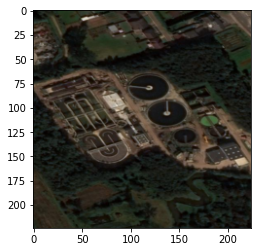

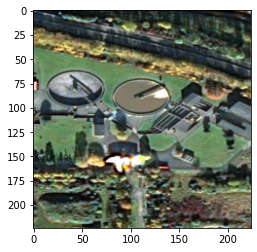

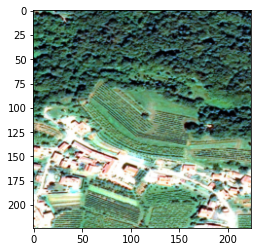

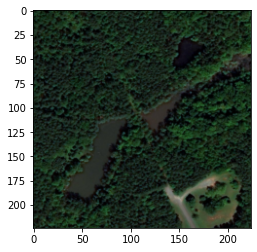

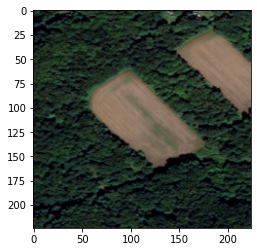

...

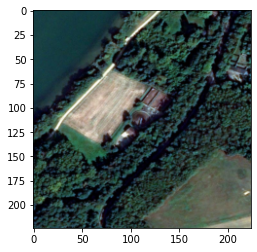

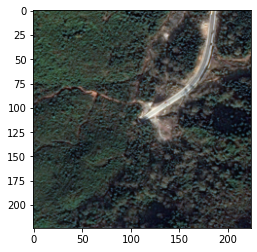

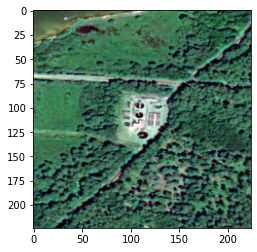

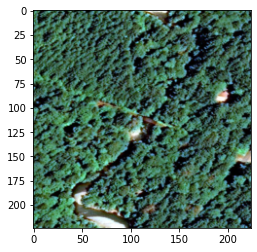

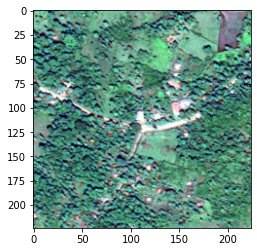

In [54]:
for im in dp["raw_input"][np.array(df.index[-30:])]:
    plt.figure()
    plt.imshow(im)

<ipython-input-55-a9b9090903f6>:2: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure()


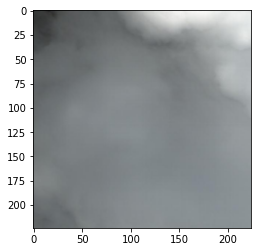

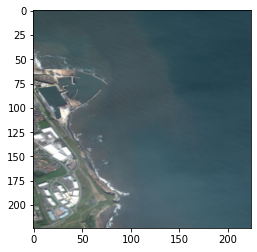

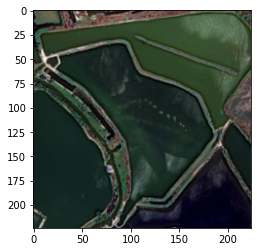

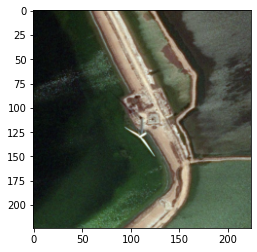

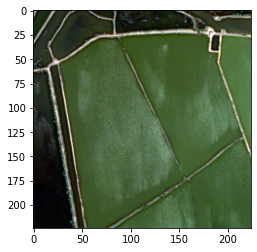

...

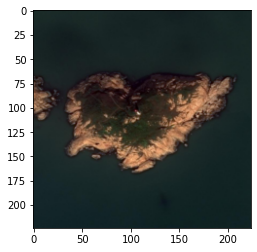

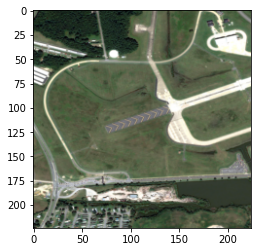

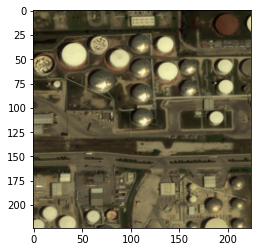

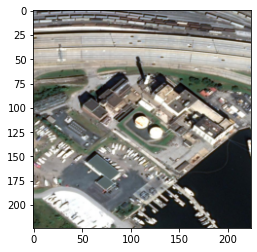

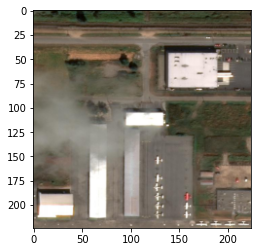

In [55]:
for im in dp["raw_input"][np.array(df.index[:30])]:
    plt.figure()
    plt.imshow(im)

<ipython-input-72-8e236d2c154c>:4: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure()


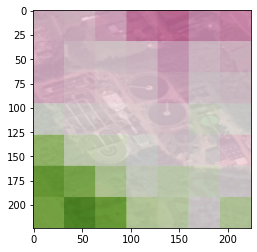

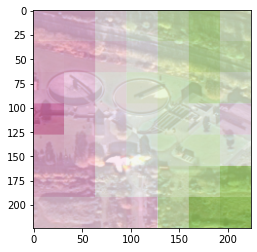

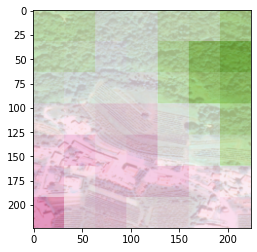

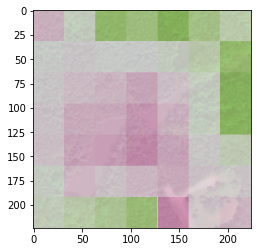

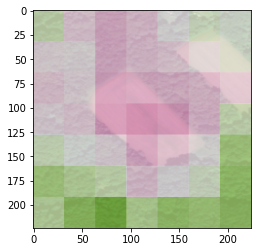

...

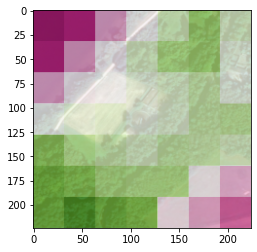

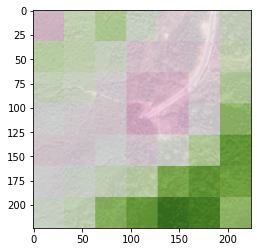

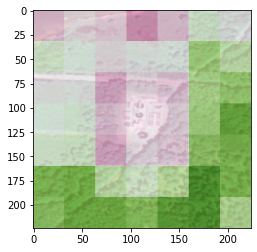

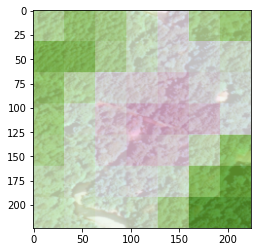

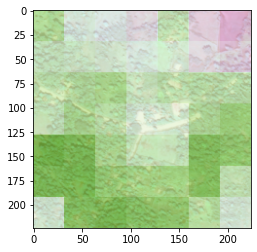

In [72]:
 global_min = dp["feedback_preds"].min()
 global_max = dp["feedback_preds"].max()
 for row in dp[np.array(df.index[-30:])]:
    _, axes = plt.subplots(1, 2)
    inp = np.array(row["raw_input"])
    axes[0].imshow(inp)
    axes[1].imshow(inp)
    
    preds = np.array(row["feedback_preds"])
    preds = preds.repeat(
        inp.shape[0] / preds.shape[0], axis=0
    ).repeat(inp.shape[1] / preds.shape[1], axis=1)
    axes[1].imshow(
        preds,
        alpha=0.79, 
        cmap="PiYG",
        vmin=global_min,
        vmax=global_max
    )

In [68]:
preds.reshape(7,7)

ValueError: cannot reshape array of size 1 into shape (7,7)

In [65]:
img["input"].shape

(3, 224, 224)